<a href="https://colab.research.google.com/github/Katrill/PM2.5/blob/main/model_PM2_5_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Описание и загрузка датасета

Присутствующие в атмосфере аэрозоли оказывают влияние на физико-химические характеристики воздуха (плотность, оптическая прозрачность и др.) и на его пригодность для дыхания и использования в технологических процессах. Высокая степень загрязненности воздуха в больших городах связана с большим количеством автомобильного транспорта и заводов, являющихся основными источниками выбросов первичных частиц-поллютантов, которые служат ядрами для дальнейшего формирования вторичных частиц и их дальнешего роста. В связи с этим актуальна задача прогноза количества частиц (в частности, PM2.5 - частицы вещества диаметром менее 2.5 мкм) в воздухе в зависимости, например, от погодных условий (температура, влажность, осадки). Так как метеорологическим явлениям свойственны циклические изменения в течение года и суток (например, суточные колебания температуры, направления ветра, превалирующие в данной местности в разные времена года), то при прогнозе стоит также рассматривать временные показатели (месяц, день, час).

***Задача:*** спрогнозировать концентрацию  PM2.5 в зависимости от времени года, суток и метеорологических условий.

Выбранный датасет содержит результаты измерений PM2.5, проводимых посольством США в Пекине, и метеорологические данные наблюдений Пекинского Международного Аэропорта. В датасете 43824 строки и 13 колонок. Датасет предназначен для EDA, визуализации данных и анализа с применением техники регрессии.
Столбцы:
*   No: номер строки;
*   Year: год;
*   Month: месяц;
*   Day: день;
*   Hour: час;
*   PM2.5: концентрация частиц (мкг/м3);
*   DEWP: точка росы (°С) - температура воздуха, при которой содержащийся в нём пар достигает состояния насыщения и начинает конденсироваться;
*   TEMP: температура (°С);
*   PRES: давление  (кПа);
*   cbwd: комбинированное направление воздуха, 4 категории. NW включает W, WNW, NW, NNW and N; NE - NNE, NE, ENE; SE - E, ESE, SE, SSE, S; SW - SSW, SW, WSW; CV - безветрие и переменчивый. Объединение E с SE и W с NW вызвано расположением основных загрязняющих предприятий Пекина;
*   Iws: кумулятивная скорость ветра (м/с);
*   Is: кумулятивное количество часов, когда шел снег;
*   Ir: кумулятивное количество часов, когда шел дождь.

Датасет взят из the Machine Learning Repository of University of California, Irvine Beijing PM2.5 Data Set (UC Irvine). The UCI page mentions the following publication as the original source of the data set: Liang, X., Zou, T., Guo, B., Li, S., Zhang, H., Zhang, S., Huang, H. and Chen, S. X. (2015). Assessing Beijing's PM2.5 pollution: severity, weather impact, APEC and winter heating. Proceedings of the Royal Society A, 471, 20150257.

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
sns.set(color_codes=True)
import plotly.express as px

In [ ]:
df = pd.read_csv("https://drive.google.com/uc?id=1mbsOpyv1L1wR93k7lGLfJCHsbUbYmBaI", encoding='cp1251')
df.head()

,No,year,month,day,hour,pm2.5,DEWP,TEMP,PRES,cbwd,Iws,Is,Ir
0,1,2010,1,1,0,NaN,-21,-11.0,1021.0,NW,1.79,0,0
1,2,2010,1,1,1,NaN,-21,-12.0,1020.0,NW,4.92,0,0
2,3,2010,1,1,2,NaN,-21,-11.0,1019.0,NW,6.71,0,0
3,4,2010,1,1,3,NaN,-21,-14.0,1019.0,NW,9.84,0,0
4,5,2010,1,1,4,NaN,-20,-12.0,1018.0,NW,12.97,0,0


# EDA

In [ ]:
# Удаляем лишний столбцы No.
df = df.drop(['No'], axis=1)
df.head()

,year,month,day,hour,pm2.5,DEWP,TEMP,PRES,cbwd,Iws,Is,Ir
0,2010,1,1,0,NaN,-21,-11.0,1021.0,NW,1.79,0,0
1,2010,1,1,1,NaN,-21,-12.0,1020.0,NW,4.92,0,0
2,2010,1,1,2,NaN,-21,-11.0,1019.0,NW,6.71,0,0
3,2010,1,1,3,NaN,-21,-14.0,1019.0,NW,9.84,0,0
4,2010,1,1,4,NaN,-20,-12.0,1018.0,NW,12.97,0,0


In [ ]:
# Для своего визуального удобства поменяем столбцы местами.
df = df.reindex(columns=['DEWP', 'TEMP', 'PRES',
       'cbwd', 'Iws', 'Is', 'Ir', 'year', 'month', 'day', 'hour', 'pm2.5'])
df.head()

,DEWP,TEMP,PRES,cbwd,Iws,Is,Ir,year,month,day,hour,pm2.5
0,-21,-11.0,1021.0,NW,1.79,0,0,2010,1,1,0,NaN
1,-21,-12.0,1020.0,NW,4.92,0,0,2010,1,1,1,NaN
2,-21,-11.0,1019.0,NW,6.71,0,0,2010,1,1,2,NaN
3,-21,-14.0,1019.0,NW,9.84,0,0,2010,1,1,3,NaN
4,-20,-12.0,1018.0,NW,12.97,0,0,2010,1,1,4,NaN


In [ ]:
# Переименуем столбцы (добавим заглавные буквы).
df = df.rename(columns={'pm2.5': 'PM2.5', 'DEWP': 'DewP', 'TEMP': 'Temp', 'PRES': 'Pres', 'cbwd': 'Cbwd', 'year': 'Year', 'day': 'Day', 'hour': 'Hour', 'month': 'Month'})
df.head()

,DewP,Temp,Pres,Cbwd,Iws,Is,Ir,Year,Month,Day,Hour,PM2.5
0,-21,-11.0,1021.0,NW,1.79,0,0,2010,1,1,0,NaN
1,-21,-12.0,1020.0,NW,4.92,0,0,2010,1,1,1,NaN
2,-21,-11.0,1019.0,NW,6.71,0,0,2010,1,1,2,NaN
3,-21,-14.0,1019.0,NW,9.84,0,0,2010,1,1,3,NaN
4,-20,-12.0,1018.0,NW,12.97,0,0,2010,1,1,4,NaN


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43824 entries, 0 to 43823
Data columns (total 12 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   DewP    43824 non-null  int64  
 1   Temp    43824 non-null  float64
 2   Pres    43824 non-null  float64
 3   Cbwd    43824 non-null  object 
 4   Iws     43824 non-null  float64
 5   Is      43824 non-null  int64  
 6   Ir      43824 non-null  int64  
 7   Year    43824 non-null  int64  
 8   Month   43824 non-null  int64  
 9   Day     43824 non-null  int64  
 10  Hour    43824 non-null  int64  
 11  PM2.5   41757 non-null  float64
dtypes: float64(4), int64(7), object(1)
memory usage: 4.0+ MB


В целевом столбце есть отсутствующие значения (2067 шт.), удалим их. Столбц Cbwd - категориальный, нужно будет закодировать. Временные показатели (год, месяц, день, час) - в числовом виде, не нужно будет преобразовывать.

In [ ]:
# Удалим отсутствующие значения.
df = df.dropna()
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 41757 entries, 24 to 43823
Data columns (total 12 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   DewP    41757 non-null  int64  
 1   Temp    41757 non-null  float64
 2   Pres    41757 non-null  float64
 3   Cbwd    41757 non-null  object 
 4   Iws     41757 non-null  float64
 5   Is      41757 non-null  int64  
 6   Ir      41757 non-null  int64  
 7   Year    41757 non-null  int64  
 8   Month   41757 non-null  int64  
 9   Day     41757 non-null  int64  
 10  Hour    41757 non-null  int64  
 11  PM2.5   41757 non-null  float64
dtypes: float64(4), int64(7), object(1)
memory usage: 4.1+ MB


In [ ]:
# Проверим, что больше пропущенных значений нет.
df.isnull().sum()

DewP     0
Temp     0
Pres     0
Cbwd     0
Iws      0
Is       0
Ir       0
Year     0
Month    0
Day      0
Hour     0
PM2.5    0
dtype: int64

In [ ]:
# Проверим наличие дупликатов рядов.
duplicate_rows_df = df[df.duplicated()]
print('number of duplicate rows: ', duplicate_rows_df.shape)

number of duplicate rows:  (0, 12)


In [ ]:
df.describe()

,DewP,Temp,Pres,Iws,Is,Ir,Year,Month,Day,Hour,PM2.5
count,41757.000000,41757.000000,41757.000000,41757.000000,41757.000000,41757.000000,41757.000000,41757.000000,41757.000000,41757.000000,41757.000000
mean,1.750174,12.401561,1016.442896,23.866747,0.055344,0.194866,2012.042771,6.513758,15.685514,11.502311,98.613215
std,14.433658,12.175215,10.300733,49.617495,0.778875,1.418165,1.415311,3.454199,8.785539,6.924848,92.050387
min,-40.000000,-19.000000,991.000000,0.450000,0.000000,0.000000,2010.000000,1.000000,1.000000,0.000000,0.000000
25%,-10.000000,2.000000,1008.000000,1.790000,0.000000,0.000000,2011.000000,4.000000,8.000000,5.000000,29.000000
50%,2.000000,14.000000,1016.000000,5.370000,0.000000,0.000000,2012.000000,7.000000,16.000000,12.000000,72.000000
75%,15.000000,23.000000,1025.000000,21.910000,0.000000,0.000000,2013.000000,10.000000,23.000000,18.000000,137.000000
max,28.000000,42.000000,1046.000000,565.490000,27.000000,36.000000,2014.000000,12.000000,31.000000,23.000000,994.000000


В столбцах Is, Ir много нулевых значений. Посмотрим их распределение.
Видим, что в целевом столбце PM2.5 Q3 - 137, а максимальное значение - 994. Такая концентрация могла образоваться в результате комбинации объемов выделения частиц источниками загрязнений с последующей нуклеацией и формированием вторичных загрязнений и метеорологических условий (скорость и направление ветра, влажность).
Удалять экстремальные значения не будем.

In [ ]:
# Скопируем датафрейм, чтобы рассмотреть изменение признаков по годам, но в исходном удалим год, так как для прогноза он не нужен.
df_date = df
df = df.drop(columns=['Year'])

In [ ]:
df_date.head()

,DewP,Temp,Pres,Cbwd,Iws,Is,Ir,Year,Month,Day,Hour,PM2.5
24,-16,-4.0,1020.0,SE,1.79,0,0,2010,1,2,0,129.0
25,-15,-4.0,1020.0,SE,2.68,0,0,2010,1,2,1,148.0
26,-11,-5.0,1021.0,SE,3.57,0,0,2010,1,2,2,159.0
27,-7,-5.0,1022.0,SE,5.36,1,0,2010,1,2,3,181.0
28,-7,-5.0,1022.0,SE,6.25,2,0,2010,1,2,4,138.0


In [ ]:
fig = px.histogram(df_date, x="Month",  y="Is", color="Year",  marginal="box", text_auto=True, title='Cumulated hours of snow')
fig.show()

По гистограмме видим, что снежные часы наблюдаются с ноября по март, что соответствует погоде в климатической зоне Пекина, следовательно, нули в остальные месяцы вполне оправданы. 

In [ ]:
fig = px.histogram(df_date, x="Month",  y="Ir", color="Year",  marginal="box", text_auto=True, title='Cumulated hours of rain')
fig.show()

Распределение "дождливых" часов также соответствует климатическим особенностям (дожди наблюдаются с весны по осень, больше всего в июле и сентябре). 


In [ ]:
fig = px.histogram(df_date, x="Month", y="Iws", color="Year",
                   title='Cumulated wind speed (m/s)', pattern_shape="Cbwd")
fig.show()

Ветры наиболее сильные с ноября по январь, также с марта по май. С июня по октябрь ветры заметно слабее. По скорости самый сильный - северо-западный ветер.

In [ ]:
# Посмотрим распраделение PM2.5 по годам и месяцам.
fig2 = px.histogram(df_date, x='Year', y='PM2.5', color='Month',
                    title='PM2.5 by year and month', histnorm='probability density', text_auto=True)
fig2.show()

По месяцам зависимость визуально не отслеживается. Например, в какие-то годы в январе была минимальная концентрация частиц, в 2013 - максимальная. Значения по годам также сильно меняются. Вероятно, в готовой модели вклад признака 'Month' будет незначительный. 

In [ ]:
df.describe(include=[object])

,Cbwd
count,41757
unique,4
top,SE
freq,14573


Выделено 4 направления ветра, пропущенных значений нет. По направлению преобладает юго-восточный ветер, хотя по скорости - северо-западный (исходя из диаграммы 'Cumulated wind speed (m/s)'). 




In [ ]:
# посмотрим, как связаны напрвление ветра и концентрация частиц.
df.groupby(['Cbwd']).mean().sort_values(by=['Iws'], ascending=False)[['DewP',	'Temp',	'Pres',	'Iws',	'Is',	'Ir', 'PM2.5']]

,DewP,Temp,Pres,Iws,Is,Ir,PM2.5
Cbwd,,,,,,,
NW,-5.270617,7.677618,1019.852269,49.724987,0.029516,0.266761,70.127633
SE,7.199067,17.532492,1012.941398,18.485031,0.098881,0.118850,110.821588
NE,0.231287,10.225399,1018.324327,7.842454,0.037006,0.331371,90.177670
cv,4.264199,12.320438,1016.007659,2.172516,0.033095,0.137746,126.151945


Самый сильный ветер NW, но наибольшие концентрации частиц наблюдаются при cv (слабый или безветрие). В безветренную погоду частицы остаются в воздухе города. Сильный NW ветер уносит частицы из города, а SE, хоть и слабее почти в 3 раза, но способствует росту содержания PM2.5, что может быть связано с раположением заводов вокруг города. 

In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

vars = ['PM2.5', 'DewP', 'Temp', 'Pres', 'Iws', 'Is', 'Ir']
fig = make_subplots(rows=1, cols=len(vars))
for i, var in enumerate(vars):
    fig.add_trace(
        go.Box(y=df[var],
        name=var),
        row=1, col=i+1
    )

fig.update_traces(boxpoints='suspectedoutliers', jitter=.2)

Как исследовано выше, для суммарных показателей дождя и снега большая часть значений 0, но остальные не являются выбросами (например, снег идет только зимой, поэтомоу большая часть значений - нули). Много выбросов в Iws и PM2.5.

In [ ]:
# Посмотрим коррелированность признаков.
corr = df.corr()
fig = px.imshow(corr,
                # .drop(['Year', 'Day', 'Hour'], axis=1),
                text_auto=True, aspect=True, color_continuous_scale=["red", "green", "blue"])
fig.show()

Сильная корреляция наблюдается между физическими показателями (температура, давление, точка росы):
Pres-DewP -0,78; 
Pres-Temp -0,83; 
Temp-DewP 0.82.

Больше 0,1:
DewP-Ir 0.13; 
DewP-Iws -0.29; 
Temp-Iws 0.15;
Temp-Hour 0.15;
Pres-Iws 0.18.

У целевого признака сильной корреляции нет ни с одним из признаков. Самые большие значения коэффициента корреляции с количеством снега и с точкой росы:  
**PM2.5**-DewP 0.17;

**PM2.5**-Iws -0.25.



In [ ]:
fig = px.scatter_matrix(df,
    dimensions=['PM2.5', 'DewP', 'Temp', 'Pres', 'Iws', 'Is', 'Ir'],
    color="Cbwd", height=1000)
fig.update_traces(diagonal_visible=False)
fig.show()

Диаграммы рассеивания подтверждают рассчитанные выше коэффициенты корреляции. Сильная корреляция между давлением, температурой и точкой росы. при построении модели нужно будет проверить, насколько эти признаки влияют на результат моделирования, стоит ли удалить какие-либо из них.
Сильно выраженной корреляции между PM2.5 и другими показателям нет. 


In [ ]:
# Посмотрим, как распределены показатели по времени. Сделаем новый датафрейм со столбцом дат.
df_date['Date'] = pd.to_datetime(df_date[['Year', 'Month', 'Day', 'Hour']])

In [ ]:
fig = px.line(df_date, x='Date', y="PM2.5", color="Cbwd")
fig.show()

По графику видно, что есть зависимость от времени года: в январе обычно концентрации частиц больше, в июле - меньше.

In [ ]:
# посмотрим, как связана концентрация частиц с месяцем.
df_month = df.groupby(['Month']).mean().sort_values(by=['PM2.5'], ascending=False)[['DewP',	'Temp',	'Pres',	'Iws',	'Is',	'Ir', 'PM2.5']]
df_month

,DewP,Temp,Pres,Iws,Is,Ir,PM2.5
Month,,,,,,,
2,-12.957012,-1.584643,1025.865846,18.090406,0.249036,0.002075,125.736140
10,5.033250,12.972059,1020.419111,13.899447,0.000000,0.161498,120.401509
1,-15.965716,-4.563814,1028.969749,33.287557,0.218957,0.004322,115.059061
11,-6.085404,4.950871,1022.610825,38.946075,0.001143,0.202228,105.762639
12,-14.586840,-2.022310,1026.480373,44.377749,0.106185,0.001977,98.200226
3,-9.053431,5.994938,1020.896513,27.355340,0.093082,0.060742,97.757593
6,16.275184,24.603818,1004.903084,11.328408,0.000000,0.238473,96.513656
7,20.572251,27.172745,1003.030436,13.701541,0.000000,0.512476,94.332328
9,13.320732,20.309031,1014.393339,10.908401,0.000000,0.535854,85.209421


В осенне-зимний период концентрация выше, чем в весенне-летний. 

In [ ]:
fig = px.line(df_date, x='Date', y="Temp", color="Cbwd")
fig.show()

In [ ]:
fig = px.line(df_date, x='Date', y="DewP", color="Cbwd")
fig.show()

Температура и точка росы циклически меняются в зависимости от времени года, что свойственно климату Пекина.

In [ ]:
fig = px.scatter(df_date, x='Date', y="DewP",color='PM2.5')
fig.show()

In [ ]:
fig = px.line(df_date, x='Date', y="Pres", color="Cbwd")
fig.show()

Давление тоже меняется сезонно - летом обычно ниже, чем зимой.

In [ ]:
# Посмотрим распределение осадков по времени года.
fig = px.line(df_date, x='Date', y=["Ir", 'Is'])
fig.show()

In [ ]:
fig = px.scatter(df, y="PM2.5", x="Iws", trendline="ols", trendline_color_override='red')
fig.show()

При слабом ветре высокая концентрация частиц - присутствует незначительная отрицательная корреляция.

In [ ]:
fig = px.scatter(df, y="PM2.5", x="Temp", trendline="ols", trendline_color_override='red')
fig.show()

Концентрация частиц выше в диапазоне температур -10 - 0 градусов.

In [ ]:
fig = px.scatter(df, x="DewP", y="PM2.5", trendline="ols", trendline_color_override='red')
fig.show()

Точка росы учитывает кроме температуры также влажность, которая может способствовать образованию вторичных частиц и росту концентрации PM2.5, что объясняет корреляцию между признаками DewP и PM2.5

In [ ]:
fig = px.scatter(df, y="PM2.5", x="Pres", trendline="ols", trendline_color_override='red')
fig.show()

In [ ]:
fig = px.scatter(df, y="PM2.5", x="Is", trendline="ols", trendline_color_override='red')
fig.show()

В снежную погоду концентарция частиц ниже. Чем дольше идет снег, тем меньше частиц в воздухе.

In [ ]:
fig = px.scatter(df, y="PM2.5", x="Ir", trendline="ols", trendline_color_override='red')
fig.show()

В дождливую погоду концентрация частиц ниже. Чем дольше идет дождь, тем меньше частиц в воздухе.

In [ ]:
fig = px.scatter(df, y="PM2.5", x="Month", trendline="ols", trendline_color_override='red')
fig.show()

Летом частиц меньше, чем зимой.

In [ ]:
fig = px.scatter(df, y="Pres", x="DewP", trendline="ols", trendline_color_override='red')
fig.show()

In [ ]:
fig = px.scatter(df, x="Temp", y="DewP", trendline="ols", trendline_color_override='red')
fig.show()

In [ ]:
fig = px.scatter(df, x="Pres", y="Temp", trendline="ols", trendline_color_override='red')
fig.show()

Давление, температура и точка росы коррелированы между собой, будем проверять значимость признаков. 

In [ ]:
fig = px.scatter(df, y="PM2.5", x="Hour", trendline="ols", trendline_color_override='red', color='Cbwd')
fig.show()

В середине дня концентрации меньше, чем утром

In [ ]:
fig = px.scatter(df, y="PM2.5", x="Day", trendline="ols", trendline_color_override='red')
fig.show()

# Линейная регрессия

In [ ]:
# Указываем целевой и незивисимые признаки.
y = df['PM2.5']
X = df.drop(['PM2.5'], axis=1)
X.head()

,DewP,Temp,Pres,Cbwd,Iws,Is,Ir,Month,Day,Hour
24,-16,-4.0,1020.0,SE,1.79,0,0,1,2,0
25,-15,-4.0,1020.0,SE,2.68,0,0,1,2,1
26,-11,-5.0,1021.0,SE,3.57,0,0,1,2,2
27,-7,-5.0,1022.0,SE,5.36,1,0,1,2,3
28,-7,-5.0,1022.0,SE,6.25,2,0,1,2,4


In [ ]:
# Кодируем категориальный призники.

from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import make_column_transformer

transformer = make_column_transformer(
    (OneHotEncoder(), ['Cbwd']),
    remainder='passthrough')

categorical_features = ['NE', 'NW', 'SE', 'cv']
transformed = transformer.fit_transform(X)
transformed_X = pd.DataFrame(
    transformed, 
    columns=transformer.get_feature_names()
)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



In [ ]:
transformer.get_feature_names()

['onehotencoder__x0_NE',
 'onehotencoder__x0_NW',
 'onehotencoder__x0_SE',
 'onehotencoder__x0_cv',
 'DewP',
 'Temp',
 'Pres',
 'Iws',
 'Is',
 'Ir',
 'Month',
 'Day',
 'Hour']

In [ ]:
# Переименуем столбцы.
transformed_X = transformed_X.rename(columns={'onehotencoder__x0_NE': 'NE', 
                                                'onehotencoder__x0_NW': 'NW', 
                                                'onehotencoder__x0_SE': 'SE',
                                                'onehotencoder__x0_cv': 'cv',
                                                'remainder__DewP': 'DewP', 
                                                'remainder__Temp': 'Temp',
                                                'remainder__Pres': 'Pres',
                                                'remainder__Hour': 'Hour',
                                                'remainder__Iws': 'Iws',
                                                'remainder__Is': 'Is',
                                                'remainder__Ir': 'Ir',
                                                'remainder__Year': 'Year',
                                                'remainder__Month': 'Month',
                                                'remainder__Day': 'Day'})

In [ ]:
transformed_X.head()

,NE,NW,SE,cv,DewP,Temp,Pres,Iws,Is,Ir,Month,Day,Hour
0,0.0,0.0,1.0,0.0,-16.0,-4.0,1020.0,1.79,0.0,0.0,1.0,2.0,0.0
1,0.0,0.0,1.0,0.0,-15.0,-4.0,1020.0,2.68,0.0,0.0,1.0,2.0,1.0
2,0.0,0.0,1.0,0.0,-11.0,-5.0,1021.0,3.57,0.0,0.0,1.0,2.0,2.0
3,0.0,0.0,1.0,0.0,-7.0,-5.0,1022.0,5.36,1.0,0.0,1.0,2.0,3.0
4,0.0,0.0,1.0,0.0,-7.0,-5.0,1022.0,6.25,2.0,0.0,1.0,2.0,4.0


In [ ]:
from sklearn.model_selection import train_test_split
# Делим датасет на тренировочные и тестовые строки в пропорции 7:3.

X_train, X_test, y_train, y_test = train_test_split(transformed_X, y, test_size=0.3, random_state=1)
print(f"Количество строк в y_train: {len(y_train)}")

Количество строк в y_train: 29229


In [ ]:
# Построим линейную регрессию и оценим R2.
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

In [ ]:
# Запускаем создание модели и предоставляем ей данные
lm =LinearRegression()
lm.fit(X_train, y_train)

LinearRegression()

In [ ]:
feature_names = list(X_train.columns)

In [ ]:
# Посмотрим, какие признаки получились наиболее значимыми.
coeffs = pd.Series(lm.coef_, index=X_train.columns.values)
coeffs.sort_values(ascending = False)

SE       13.924475
cv       13.356848
DewP      4.462456
Hour      1.284204
Day       0.739226
Iws      -0.203700
Month    -1.146026
Pres     -1.567194
Is       -3.350323
Ir       -6.479718
Temp     -6.671718
NW      -13.585009
NE      -13.696314
dtype: float64

In [ ]:
# Проверяем модель на тестовых данных
predicted = lm.predict(X_test)

In [ ]:
mae = np.mean(abs(predicted-y_test))
rmse = np.sqrt(np.mean((predicted-y_test)**2))
rae = np.mean(abs(predicted-y_test))/np.mean(abs(y_test-np.mean(y_test)))
rse = np.mean((predicted-y_test)**2)/np.mean((y_test-np.mean(y_test))**2)
print("The R-squared value is: {0:0.4f}".format(lm.score(X_test, y_test))) 
print("Mean Absolute Error: {0:0.6f}".format(mae)) 
print("Root Mean Squared Error: {0:0.6f}".format(rmse)) 
print("Relative Absolute Error: {0:0.6f}".format(rae)) 
print("Relative Squared Error: {0:0.6f}".format(rse))

The R-squared value is: 0.2724
Mean Absolute Error: 56.370014
Root Mean Squared Error: 77.237132
Relative Absolute Error: 0.830260
Relative Squared Error: 0.727550


Точность модели низкая (R2=0.2725). Самые значимые признаки - направление ветра, причем SE и cv способствуют росту PM2.5, а NW и NE, наоборот, - уменьшению целевого показателя.

# Variance Threshold

In [ ]:
# Проверим, есть ли признаки с низкой дисперсией и удалим их. 
from sklearn.feature_selection import VarianceThreshold #Селектор функций, который удаляет все функции с низкой дисперсией
from sklearn.preprocessing import StandardScaler # Разные атрибуты могут измеряться в разных диапазонах и, соответственно, оказывать разное влияние на модель, поэтому необходимо их привести к одинаковому диапазону. 
from sklearn.pipeline import Pipeline # Библиотека преобразователей (конвейер), которые могут очищать, уменьшать, расширять или генерировать представление функций.

In [ ]:
pipline_1 = Pipeline([
    ("scaler", StandardScaler()),
    ("selector", VarianceThreshold(threshold=.001))
])
# базовый подход к выбору функций: удаляет все функции, дисперсия которых не соответствует порогу. По умолчанию он удаляет все признаки с нулевой дисперсией, то есть признаки, которые имеют одинаковое значение во всех выборках.

In [ ]:
X_selector = pipline_1.fit_transform(transformed_X)
print('Число фичей в датасете:', transformed_X.shape[1]) # shape() shape[1] - количество столбцов, shape[0] - количество строк
print('Число фичей после Filter  VarianceThreshold:', X_selector.shape[1])

Число фичей в датасете: 13
Число фичей после Filter  VarianceThreshold: 13


Не нашлось признаков с низкой дисперсией, оставляем 13 шт.

# Линейная регрессия со стандартизацией признаков

In [ ]:
from sklearn.preprocessing import MinMaxScaler

pipe = Pipeline([
    ("scaler", MinMaxScaler()),
    ("MMSregr", LinearRegression())
])

In [ ]:
result = pipe.fit(X_train,y_train)

In [ ]:
y_pred = pipe.predict(X_test)

In [ ]:
pipe.named_steps["scaler"].transform(X_train)

array([[1.        , 0.        , 0.        , ..., 0.54545455, 0.43333333,
        0.2173913 ],
       [0.        , 1.        , 0.        , ..., 0.81818182, 0.5       ,
        0.82608696],
       [0.        , 0.        , 0.        , ..., 0.90909091, 0.13333333,
        0.52173913],
       ...,
       [0.        , 1.        , 0.        , ..., 0.63636364, 0.63333333,
        0.30434783],
       [0.        , 1.        , 0.        , ..., 0.54545455, 0.2       ,
        0.39130435],
       [0.        , 1.        , 0.        , ..., 1.        , 0.86666667,
        0.39130435]])

In [ ]:
print("The R-squared value is: {0:0.4f}".format(result.score(X_test, y_test)))
rmse = np.sqrt(np.mean((y_pred-y_test)**2))
print("Root Mean Squared Error: {0:0.4f}" .format(rmse)) 

The R-squared value is: 0.2725
Root Mean Squared Error: 77.2320


In [ ]:
coeffs = pd.Series(result.named_steps['MMSregr'].coef_, index=X_train.columns.values)
coeffs.sort_values(ascending = False)

DewP     2.989961e+02
Hour     2.953906e+01
Day      2.217773e+01
Month   -1.262695e+01
Is      -8.377124e+01
Pres    -8.619531e+01
Iws     -1.150938e+02
Ir      -2.268193e+02
Temp    -4.003125e+02
SE      -4.044278e+14
cv      -4.044278e+14
NE      -4.044278e+14
NW      -4.044278e+14
dtype: float64

Точность линейной регрессии после стандартизации значений не изменилась, но коэффициенты поменялись значительно. Наибольший вклад по модулю у признаков DewP (положительный) и у всех направлений ветра (отрицательный).

# RFECV

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
from sklearn import preprocessing
from sklearn.feature_selection import RFECV

lm = LinearRegression()

In [ ]:
min_mascaler =  preprocessing.MinMaxScaler()
scaled_minmax = min_mascaler.fit_transform(X_train)
scaled_minmadf = pd.DataFrame(scaled_minmax, columns = feature_names)

In [ ]:
# Проведем ранжирование признаков.
rfecv = RFECV(estimator=lm, step=1, cv=10) 
rfecv.fit(scaled_minmadf, y_train)
print("Optimal number of features: %d" % rfecv.n_features_)
print(rfecv.ranking_)

Optimal number of features: 13
[1 1 1 1 1 1 1 1 1 1 1 1 1]


Все признаки равнозначны, нет тех, которые оказывают слабое влияние на результат и могут быть исключены.

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:103: FutureWarning:

The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.



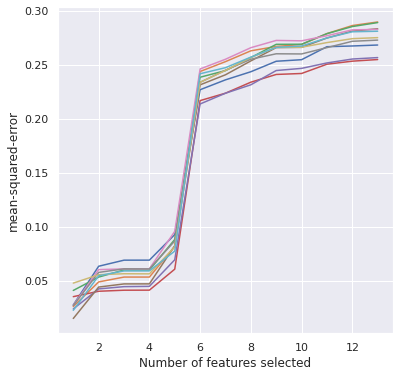

In [ ]:
# Посмотрим графическое отображение результатов ранжирования.
plt.figure(figsize=(6, 6)) 
plt.xlabel("Number of features selected") 
plt.ylabel("mean-squared-error") 
plt.plot(range(1, len(rfecv.grid_scores_) + 1), rfecv.grid_scores_)

Не будем удалять признаки.

# Дерево решений

In [ ]:
!pip install -q dtreeviz
from dtreeviz.trees import *
from IPython.display import Image, display_svg, SVG
from sklearn import tree

In [ ]:
from sklearn.tree import DecisionTreeRegressor
regr = DecisionTreeRegressor(max_depth=4, min_samples_leaf=5)
regr.fit(X_train, y_train)

DecisionTreeRegressor(max_depth=4, min_samples_leaf=5)

In [ ]:
regr.feature_importances_

array([0.00000000e+00, 8.72101310e-02, 3.74540070e-03, 0.00000000e+00,
       3.22025440e-01, 3.29583710e-01, 0.00000000e+00, 1.56281425e-01,
       0.00000000e+00, 0.00000000e+00, 1.00890936e-01, 2.62957958e-04,
       0.00000000e+00])

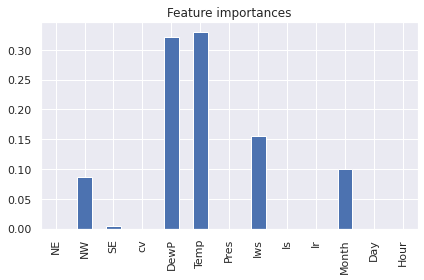

In [ ]:
tree_importances = pd.Series(regr.feature_importances_, index=feature_names)

fig, ax = plt.subplots()
tree_importances.plot.bar(ax=ax)
ax.set_title("Feature importances")
fig.tight_layout()

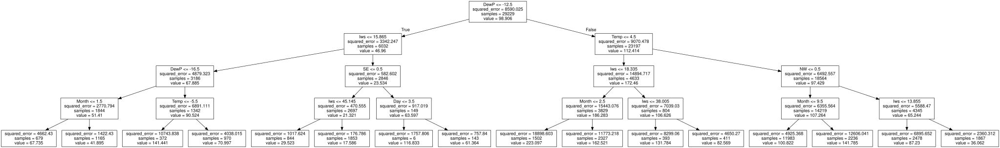

In [ ]:
tree = tree.export_graphviz(regr, feature_names=feature_names)  
graph = graphviz.Source(tree)  
graph 

In [ ]:
predicted = regr.predict(X_test)
mae = np.mean(abs(predicted-y_test))
rmse = np.sqrt(np.mean((predicted-y_test)**2))
rae = np.mean(abs(predicted-y_test))/np.mean(abs(y_test-np.mean(y_test)))
rse = np.mean((predicted-y_test)**2)/np.mean((y_test-np.mean(y_test))**2)
print("The R-squared value is: {0:0.4f}".format(regr.score(X_test, y_test))) 
print("Mean Absolute Error: {0:0.6f}".format(mae)) 
print("Root Mean Squared Error: {0:0.6f}".format(rmse)) 
print("Relative Absolute Error: {0:0.6f}".format(rae)) 
print("Relative Squared Error: {0:0.6f}".format(rse))

The R-squared value is: 0.2653
Mean Absolute Error: 55.925228
Root Mean Squared Error: 77.613730
Relative Absolute Error: 0.823709
Relative Squared Error: 0.734662


При использовании четырехуровневого дерева решений R2 почти не изменился (0,2653). При добавлении пятого уровня R2~0.33 (вырос незначимо), но при этом получились листья, содержащие всего 3 образца. 

# Bagging

In [ ]:
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import BaggingRegressor

Bagging = BaggingRegressor(n_estimators=30, random_state=1).fit(X_train, y_train)

In [ ]:
predicted_Bagging = Bagging.predict(X_test)
mae = np.mean(abs(predicted_Bagging-y_test))
rmse = np.sqrt(np.mean((predicted_Bagging-y_test)**2))
rae = np.mean(abs(predicted_Bagging-y_test))/np.mean(abs(y_test-np.mean(y_test)))
rse = np.mean((predicted_Bagging-y_test)**2)/np.mean((y_test-np.mean(y_test))**2)
print("The R-squared value is: {0:0.4f}".format(Bagging.score(X_test, y_test))) 
print("Mean Absolute Error: {0:0.6f}".format(mae)) 
print("Root Mean Squared Error: {0:0.6f}".format(rmse)) 
print("Relative Absolute Error: {0:0.6f}".format(rae)) 
print("Relative Squared Error: {0:0.6f}".format(rse))

The R-squared value is: 0.7941
Mean Absolute Error: 26.185470
Root Mean Squared Error: 41.084219
Relative Absolute Error: 0.385679
Relative Squared Error: 0.205855


На тестовом множестве результат (R2 = 0,7941) значительно лучше, чем в других, выше использованных методах. Увеличение числа оценщиков с 5 до 30 повышает точность на 6%.

# Случайный лес

In [ ]:
from sklearn.metrics import r2_score
from sklearn.ensemble import RandomForestRegressor

In [ ]:
rf = RandomForestRegressor(n_estimators=100, random_state=1)
rf.fit(X_train, y_train)
predicted_rf = rf.predict(X_test)
mae = np.mean(abs(predicted_rf-y_test))
rmse = np.sqrt(np.mean((predicted_rf-y_test)**2))
rae = np.mean(abs(predicted_rf-y_test))/np.mean(abs(y_test-np.mean(y_test)))
rse = np.mean((predicted_rf-y_test)**2)/np.mean((y_test-np.mean(y_test))**2)
print('R2 score on testing data: {:.4f}'.format(r2_score(y_test, predicted_rf)))
print("Mean Absolute Error: {0:0.6f}".format(mae)) 
print("Root Mean Squared Error: {0:0.6f}".format(rmse)) 
print("Relative Absolute Error: {0:0.6f}".format(rae)) 
print("Relative Squared Error: {0:0.6f}".format(rse))

R2 score on testing data: 0.8003
Mean Absolute Error: 25.808981
Root Mean Squared Error: 40.465752
Relative Absolute Error: 0.380134
Relative Squared Error: 0.199704


На тестовом множестве получена точность 0,8003 (немного выше, чем при беггинге). Дальнейший прирост числа деревьев не дает значимого увеличения R2.

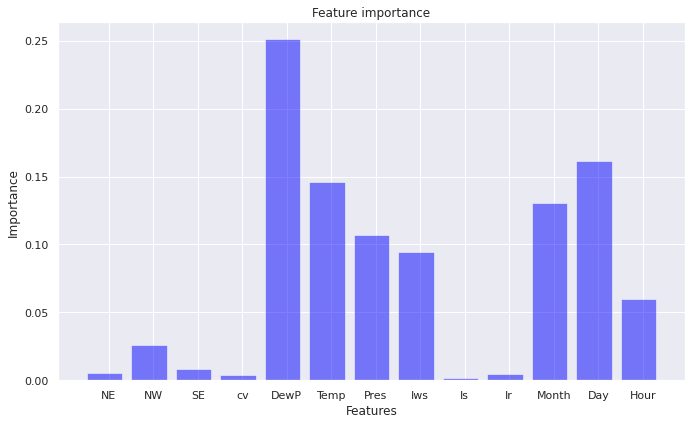

In [ ]:
feat_imp = rf.feature_importances_

plt.figure(figsize=(6 * 1.618, 6))
feature_names=feature_names
index = np.arange(len(feature_names))
bar_width = 0.5
plt.bar(index, feat_imp, color='blue', alpha=0.5, align='edge')
plt.xlabel('Features')
plt.ylabel('Importance')
plt.title('Feature importance')
plt.xticks(index + bar_width, np.array(feature_names))
plt.tight_layout()
plt.show()

# AdaBoost

In [ ]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import AdaBoostRegressor
AdaBoost = AdaBoostRegressor(DecisionTreeRegressor(max_depth=4),
                          n_estimators=5, random_state=1)
AdaBoost.fit(X_train, y_train)

AdaBoostRegressor(base_estimator=DecisionTreeRegressor(max_depth=4),
                  n_estimators=5, random_state=1)

In [ ]:
predicted_AdaBoost = AdaBoost.predict(X_test)
mae = np.mean(abs(predicted_AdaBoost-y_test))
rmse = np.sqrt(np.mean((predicted_AdaBoost-y_test)**2))
rae = np.mean(abs(predicted_AdaBoost-y_test))/np.mean(abs(y_test-np.mean(y_test)))
rse = np.mean((predicted_AdaBoost-y_test)**2)/np.mean((y_test-np.mean(y_test))**2)
print('R2 score on testing data: {:.4f}'.format(r2_score(y_test, predicted_AdaBoost)))
print("Mean Absolute Error: {0:0.6f}".format(mae)) 
print("Root Mean Squared Error: {0:0.6f}".format(rmse)) 
print("Relative Absolute Error: {0:0.6f}".format(rae)) 
print("Relative Squared Error: {0:0.6f}".format(rse))

R2 score on testing data: 0.3056
Mean Absolute Error: 57.441400
Root Mean Squared Error: 75.457284
Relative Absolute Error: 0.846040
Relative Squared Error: 0.694405


Невысокая точность предсказаний (R2 = 0.3056).

# SGDRegressor

In [ ]:
from sklearn.linear_model import SGDRegressor
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
reg_sgdr = make_pipeline(StandardScaler(),
                    SGDRegressor(max_iter=1000, tol=1e-3,
                                 penalty='l1', alpha=0.2, random_state=1,
                                 verbose=0, eta0=0.001))
reg_sgdr.fit(X_train, y_train)
y_pred_sgdr = reg_sgdr.predict(X_test)

mae = np.mean(abs(y_pred_sgdr-y_test))
rmse = np.sqrt(np.mean((y_pred_sgdr-y_test)**2))
rae = np.mean(abs(y_pred_sgdr-y_test))/np.mean(abs(y_test-np.mean(y_test)))
rse = np.mean((y_pred_sgdr-y_test)**2)/np.mean((y_test-np.mean(y_test))**2)
print('R2 score on testing data: {:.4f}'.format(r2_score(y_test, y_pred_sgdr)))
print("Mean Absolute Error: {0:0.6f}".format(mae)) 
print("Root Mean Squared Error: {0:0.6f}".format(rmse)) 
print("Relative Absolute Error: {0:0.6f}".format(rae)) 
print("Relative Squared Error: {0:0.6f}".format(rse))


R2 score on testing data: 0.2726
Mean Absolute Error: 56.316018
Root Mean Squared Error: 77.227987
Relative Absolute Error: 0.829464
Relative Squared Error: 0.727378


In [ ]:
coeffs = pd.Series(reg_sgdr.named_steps['sgdregressor'].coef_, index=X_train.columns.values)
coeffs.sort_values(ascending = False)

DewP     63.293978
Hour      8.353551
Day       6.358088
SE        5.122409
cv        4.222378
Is       -2.482298
Month    -3.752947
NE       -5.096159
NW       -7.757831
Ir       -8.861263
Iws     -10.347697
Pres    -15.291590
Temp    -79.143332
dtype: float64

Точность невысокая (0,2726). Наиболее значительные вклады: DewP (положительный) и Temp (отрицательный).

# XGBoost

In [ ]:
import xgboost as xgb

In [ ]:
data_dmatrix_2 = xgb.DMatrix(data=transformed_X,label=y)

In [ ]:
xg_reg = xgb.XGBRegressor(colsample_bytree = 0.9, learning_rate = 0.1,
max_depth = 5, alpha = 10, n_estimators = 150)

In [ ]:
xg_reg.fit(X_train,y_train)

[06:18:45] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


XGBRegressor(alpha=10, colsample_bytree=0.9, max_depth=5, n_estimators=150)

In [ ]:
preds_1 = xg_reg.predict( X_test)

In [ ]:
mae = np.mean(abs(preds_1-y_test))
rmse = np.sqrt(np.mean((preds_1-y_test)**2))
rae = np.mean(abs(preds_1-y_test))/np.mean(abs(y_test-np.mean(y_test)))
rse = np.mean((preds_1-y_test)**2)/np.mean((y_test-np.mean(y_test))**2)
print("The R-squared value is: {0:0.4f} \n".format(r2_score(preds_1,y_test)))
print("Mean Absolute Error: {0:0.6f}".format(mae)) 
print("Root Mean Squared Error: {0:0.6f}".format(rmse)) 
print("Relative Absolute Error: {0:0.6f}".format(rae)) 
print("Relative Squared Error: {0:0.6f}".format(rse))

The R-squared value is: 0.3984 

Mean Absolute Error: 36.823083
Root Mean Squared Error: 53.461088
Relative Absolute Error: 0.542358
Relative Squared Error: 0.348567


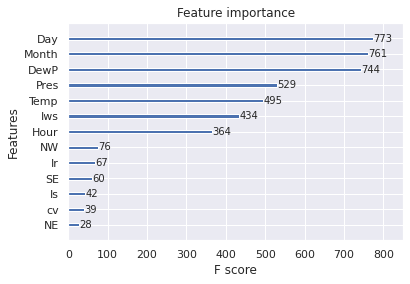

In [ ]:
xgb.plot_importance(xg_reg)
plt.rcParams['figure.figsize'] = [5, 2]
plt.show()

Точность невысокая 0,3984.

# Catboost

In [ ]:
!pip install catboost

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from catboost import  Pool, CatBoostRegressor
cat = CatBoostRegressor()

In [ ]:
cat.fit(X_train,y_train,verbose=False, plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [ ]:
pred_cat = cat.predict(X_test)

In [ ]:
mae = np.mean(abs(pred_cat-y_test))
rmse = np.sqrt(np.mean((pred_cat-y_test)**2))
rae = np.mean(abs(pred_cat-y_test))/np.mean(abs(y_test-np.mean(y_test)))
rse = np.mean((pred_cat-y_test)**2)/np.mean((y_test-np.mean(y_test))**2)
print("The R-squared value is: {0:0.4f} \n".format(r2_score(pred_cat,y_test)))
print("Mean Absolute Error: {0:0.6f}".format(mae)) 
print("Root Mean Squared Error: {0:0.6f}".format(rmse)) 
print("Relative Absolute Error: {0:0.6f}".format(rae)) 
print("Relative Squared Error: {0:0.6f}".format(rse))

The R-squared value is: 0.5639 

Mean Absolute Error: 33.347403
Root Mean Squared Error: 48.526169
Relative Absolute Error: 0.491165
Relative Squared Error: 0.287186


In [ ]:
pd.DataFrame({'feature_importance': cat.get_feature_importance(), 
              'feature_names': feature_names}).sort_values(by=['feature_importance'], 
                                                           ascending=False)

,feature_importance,feature_names
10,28.898368,Month
4,28.442818,DewP
11,12.689896,Day
5,8.929041,Temp
7,7.379229,Iws
6,6.913775,Pres
12,2.711940,Hour
2,1.702253,SE
1,1.036490,NW
9,0.454200,Ir


In [ ]:
for key,value in cat.get_all_params().items():
 print('{}, {}'.format(key,value))

nan_mode, Min
eval_metric, RMSE
iterations, 1000
sampling_frequency, PerTree
leaf_estimation_method, Newton
grow_policy, SymmetricTree
penalties_coefficient, 1
boosting_type, Plain
model_shrink_mode, Constant
feature_border_type, GreedyLogSum
bayesian_matrix_reg, 0.10000000149011612
eval_fraction, 0
force_unit_auto_pair_weights, False
l2_leaf_reg, 3
random_strength, 1
rsm, 1
boost_from_average, True
model_size_reg, 0.5
pool_metainfo_options, {'tags': {}}
subsample, 0.800000011920929
use_best_model, False
random_seed, 0
depth, 6
posterior_sampling, False
border_count, 254
classes_count, 0
auto_class_weights, None
sparse_features_conflict_fraction, 0
leaf_estimation_backtracking, AnyImprovement
best_model_min_trees, 1
model_shrink_rate, 0
min_data_in_leaf, 1
loss_function, RMSE
learning_rate, 0.06978800147771835
score_function, Cosine
task_type, CPU
leaf_estimation_iterations, 1
bootstrap_type, MVS
max_leaves, 64


# Итоги
В данном блокноте проведен EDA, изучены SKlearn, CatBoost и XGBoost, получены оценки точности моделей, построенных этими методами. В следующем блокноте рассмотрим Pycaret.
 








